In [1]:
import numpy as np
from numpy.random import randint
import matplotlib
matplotlib.use('nbAgg')
from matplotlib import cm, pyplot as plt
from imageio import imread, imsave
from numpy.random import randint
plt.rcParams['figure.figsize'] = (16,10)

# Problem 1

Complete the following function, by implementing the anisotropic diusion algorithm found in 10.1 for black and white images.
Run the function on balloon.jpg. Show the original image and the diused image for σ = .1,
λ = .25, N = 5, 20, 100.

In [2]:
def anisdiff_bw(U, N, lambda_, g):
    """ Run the Anisotropic Diffusion differencing scheme
    on the array U of grayscale values for an image.
    Perform N iterations, use the function g
    to limit diffusion across boundaries in the image.
    Operate on U inplace to optimize performance. """
    U = np.pad(U,1,mode='edge') #pad the array with the edge values
    
    #finite differencing methods
    for i in range(N):
        U[1:-1,1:-1] += lambda_*g(np.abs(U[1:-1,:-2] - U[1:-1,1:-1]))*(U[1:-1,:-2] - U[1:-1,1:-1])
        U[1:-1,1:-1] += lambda_*g(np.abs(U[1:-1,2:] - U[1:-1,1:-1]))*(U[1:-1,2:] - U[1:-1,1:-1])
        U[1:-1,1:-1] += lambda_*g(np.abs(U[:-2,1:-1] - U[1:-1,1:-1]))*(U[:-2,1:-1] - U[1:-1,1:-1])
        U[1:-1,1:-1] += lambda_*g(np.abs(U[2:,1:-1] - U[1:-1,1:-1]))*(U[2:,1:-1] - U[1:-1,1:-1])
    plt.imshow(U[1:-1,1:-1],cmap=cm.gray)
    plt.title(f"N={N},λ={lambda_},σ={σ}")
    plt.show()

C:\Users\sgold\AppData\Local\Temp/ipykernel_32968/2230634087.py:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  U = imread('balloon.jpg',as_gray=True) * 1./255


<IPython.core.display.Javascript object>


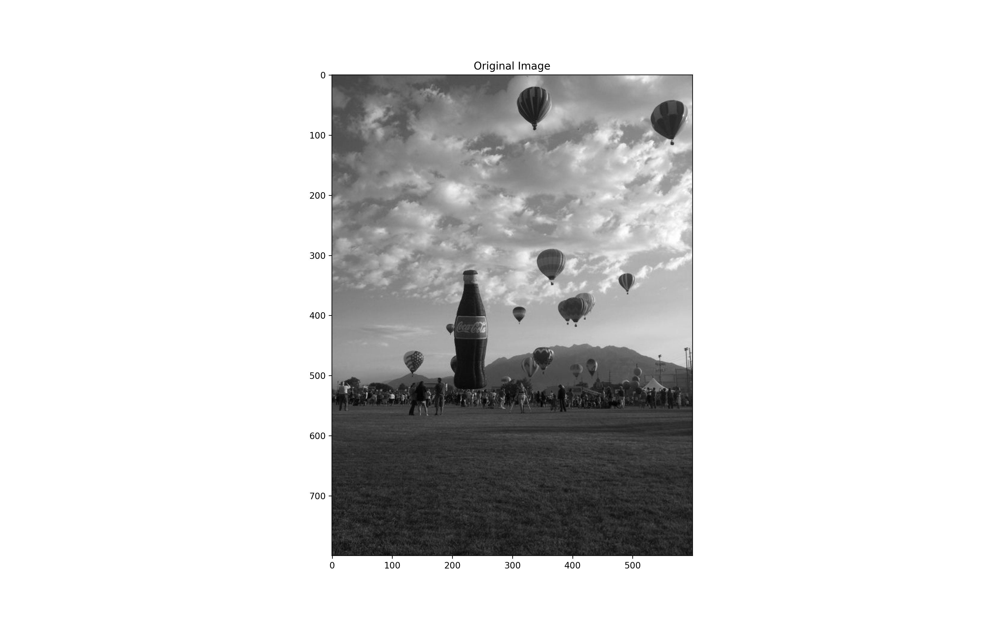

C:\Users\sgold\AppData\Local\Temp/ipykernel_32968/2230634087.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  U = imread('balloon.jpg',as_gray=True) * 1./255


<IPython.core.display.Javascript object>


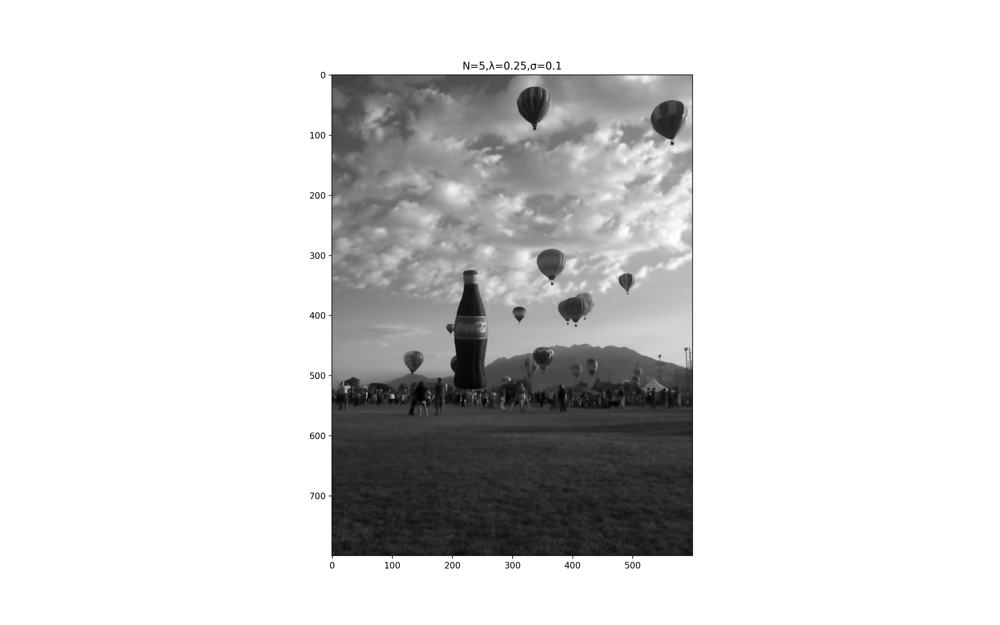

<IPython.core.display.Javascript object>


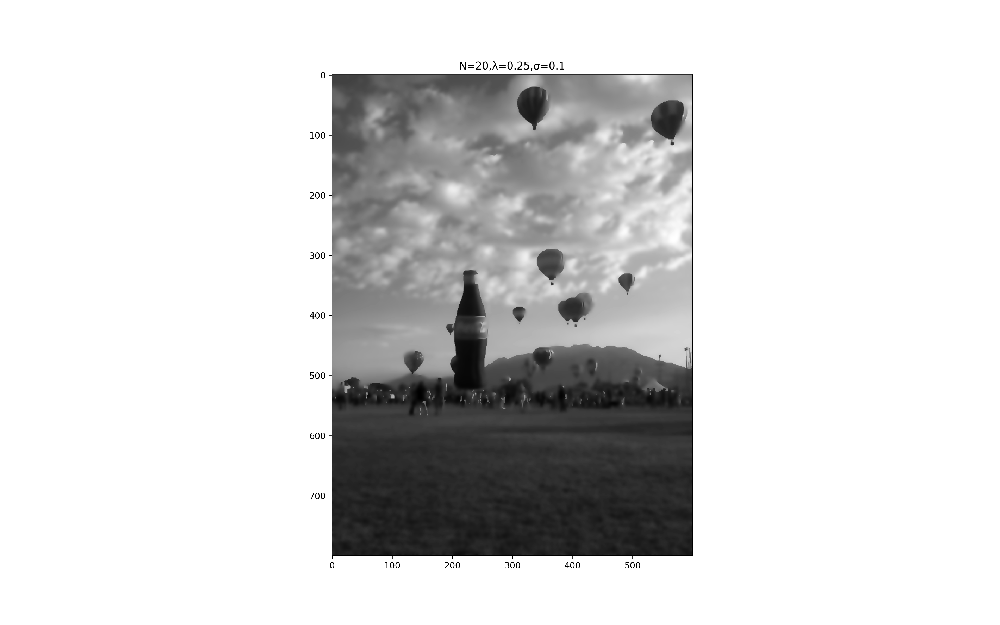

<IPython.core.display.Javascript object>


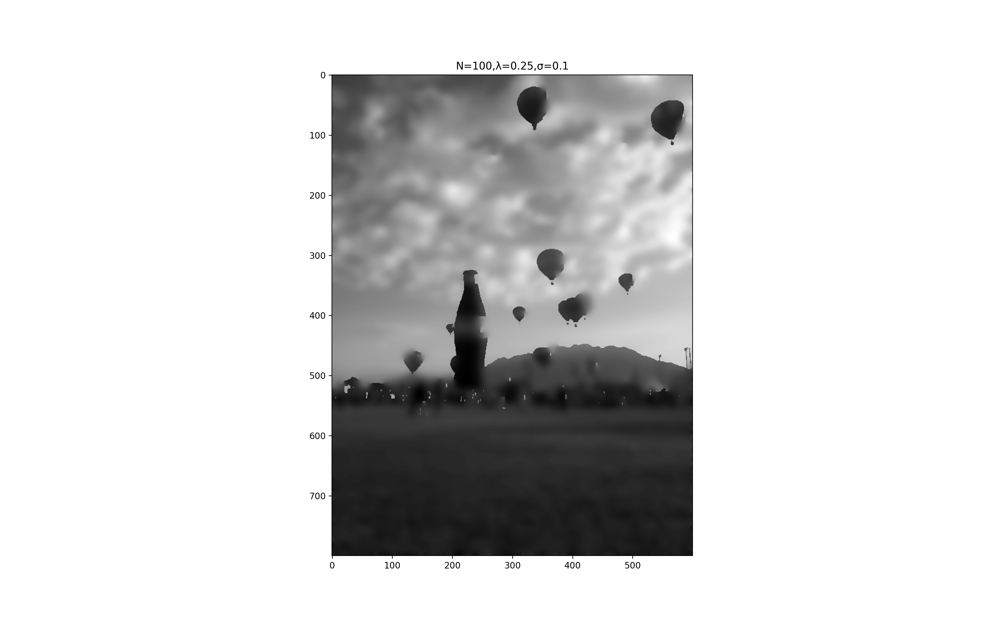

In [3]:
σ, λ = .1, 0.25
g = lambda x: np.exp(-(x/σ)**2)

U = imread('balloon.jpg',as_gray=True) * 1./255
plt.imshow(U,cmap=cm.gray)
plt.title("Original Image")
plt.show()

for N in [5,20,100]:
    U = imread('balloon.jpg',as_gray=True) * 1./255
    anisdiff_bw(U,N,λ,g)

# Problem 2

Complete the following function to process a colored image.
Run the function on balloons_color.jpg. Show the original image and the diused image for
σ = .1, λ = .25, N = 5, 20, 100.

In [4]:
def anisdiff_color(U, N, lambda_, g):
    """ Run the Anisotropic Diffusion differencing scheme
    on the array U of grayscale values for an image.
    Perform N iterations, use the function g = e^{-x^2/sigma^2}
    to limit diffusion across boundaries in the image.
    Operate on U inplace to optimize performance. """ 
    U = np.pad(U,1,mode='edge') #pad the whole array with the value at the edge
    
    #apply the finite differencing method
    for i in range(N):
        U[1:-1,1:-1,1:-1] += lambda_*g(np.linalg.norm(U[1:-1,:-2,1:-1] - U[1:-1,1:-1,1:-1],ord=2,axis=2,keepdims=True))*(U[1:-1,:-2,1:-1] - U[1:-1,1:-1,1:-1])
        U[1:-1,1:-1,1:-1] += lambda_*g(np.linalg.norm(U[1:-1,2:,1:-1] - U[1:-1,1:-1,1:-1],ord=2,axis=2,keepdims=True))*(U[1:-1,2:,1:-1] - U[1:-1,1:-1,1:-1])
        U[1:-1,1:-1,1:-1] += lambda_*g(np.linalg.norm(U[:-2,1:-1,1:-1] - U[1:-1,1:-1,1:-1],ord=2,axis=2,keepdims=True))*(U[:-2,1:-1,1:-1] - U[1:-1,1:-1,1:-1])
        U[1:-1,1:-1,1:-1] += lambda_*g(np.linalg.norm(U[2:,1:-1,1:-1] - U[1:-1,1:-1,1:-1],ord=2,axis=2,keepdims=True))*(U[2:,1:-1,1:-1] - U[1:-1,1:-1,1:-1])

    plt.imshow(U[1:-1,1:-1,1:-1])
    plt.title(f"N={N},λ={lambda_},σ={σ}")
    plt.show()

C:\Users\sgold\AppData\Local\Temp/ipykernel_32968/441777448.py:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  U = imread('balloons_color.jpg',as_gray=False) * 1./255


<IPython.core.display.Javascript object>


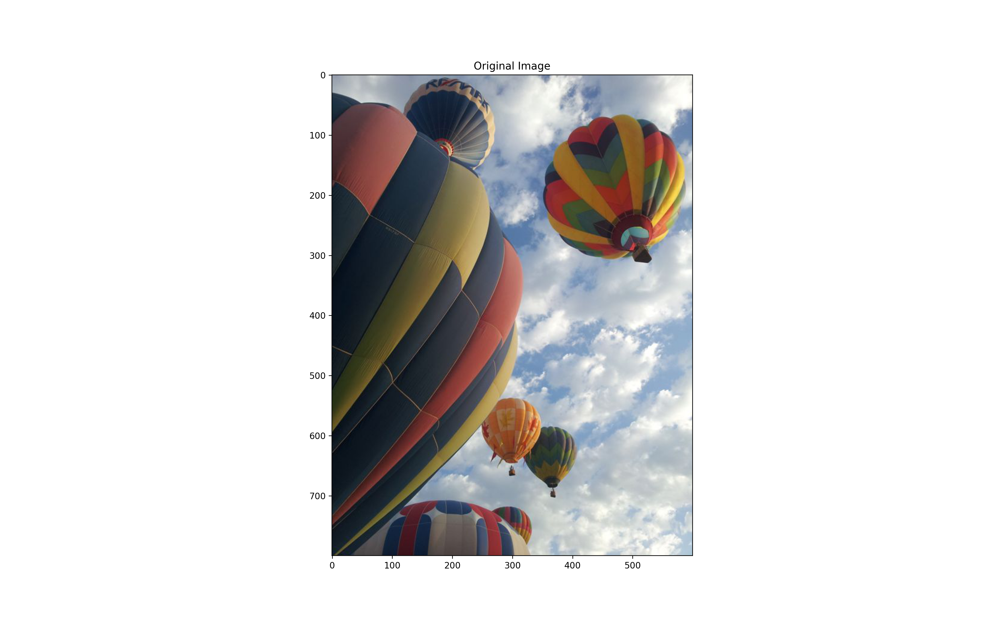

C:\Users\sgold\AppData\Local\Temp/ipykernel_32968/441777448.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  U = imread('balloons_color.jpg',as_gray=False) * 1./255


<IPython.core.display.Javascript object>


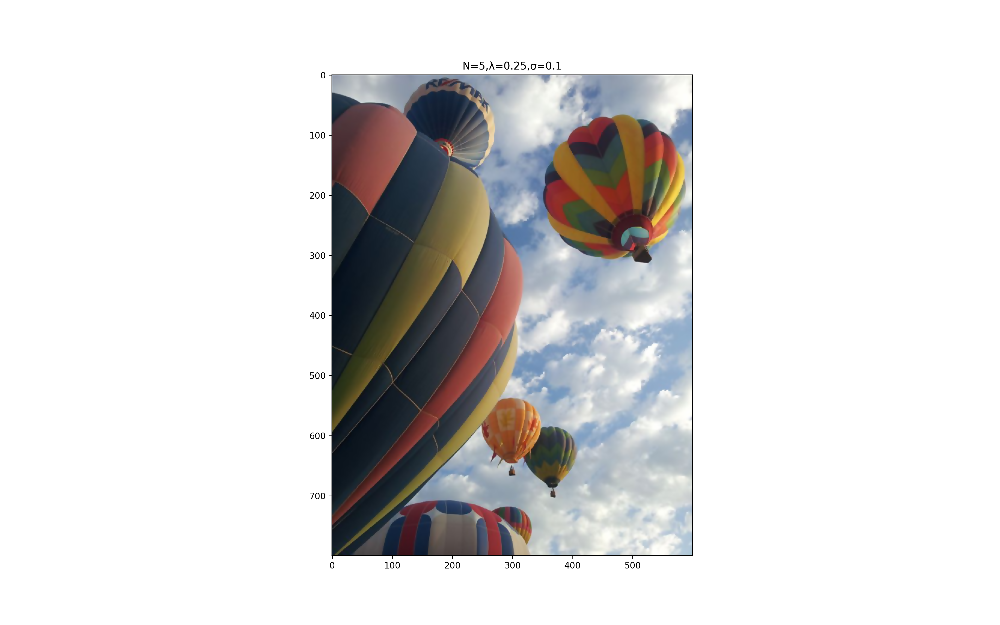

<IPython.core.display.Javascript object>


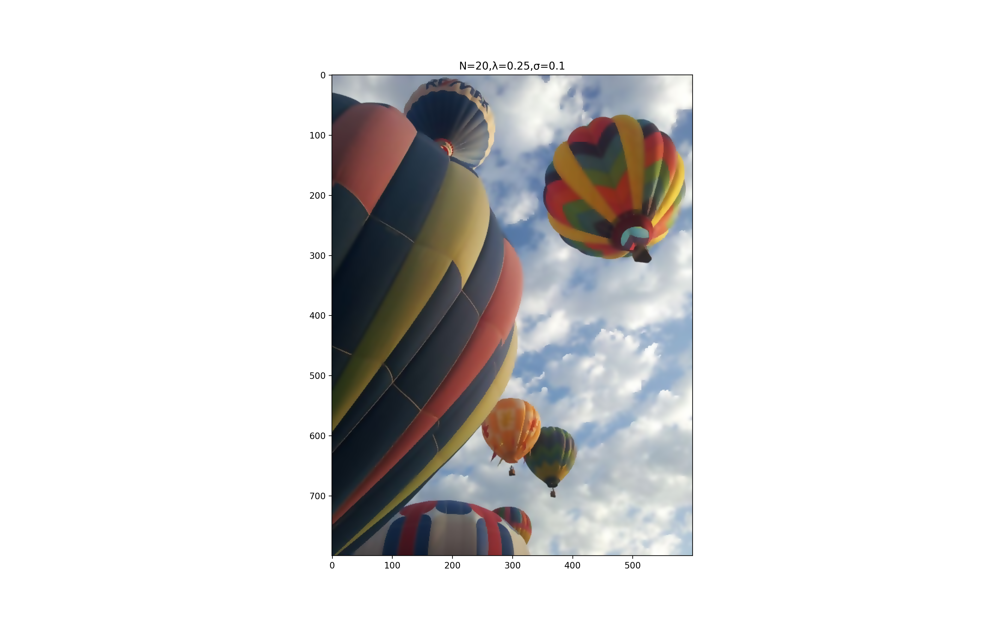

<IPython.core.display.Javascript object>


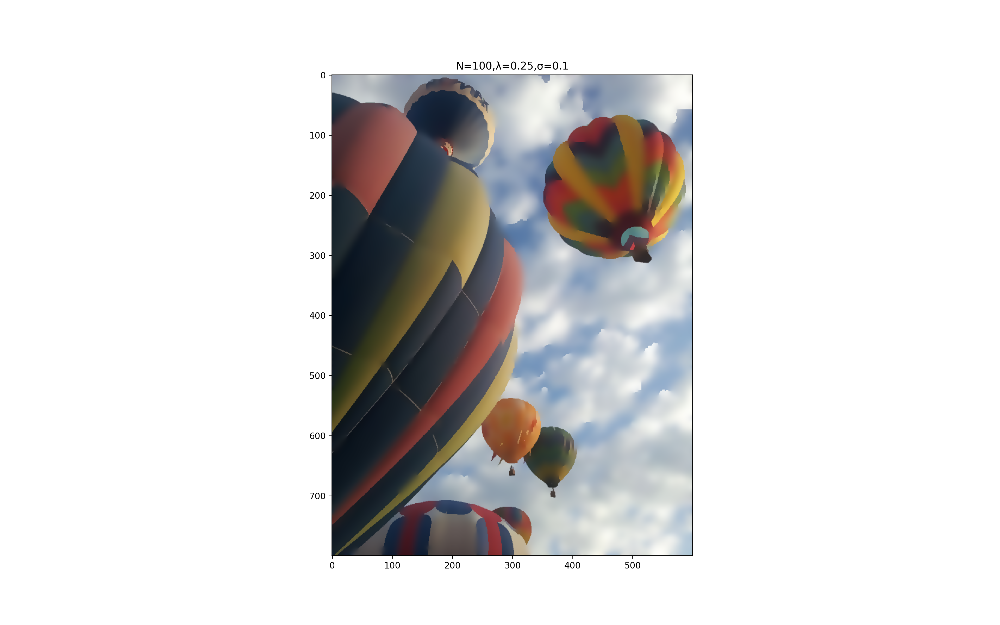

In [5]:
σ, λ = .1, 0.25
g = lambda x: np.exp(-(x/σ)**2)

U = imread('balloons_color.jpg',as_gray=False) * 1./255
plt.title("Original Image")
plt.imshow(U)
plt.show()

for N in [5,20,100]:
    U = imread('balloons_color.jpg',as_gray=False) * 1./255
    anisdiff_color(U,N,λ,g)

Test with N=50

<IPython.core.display.Javascript object>


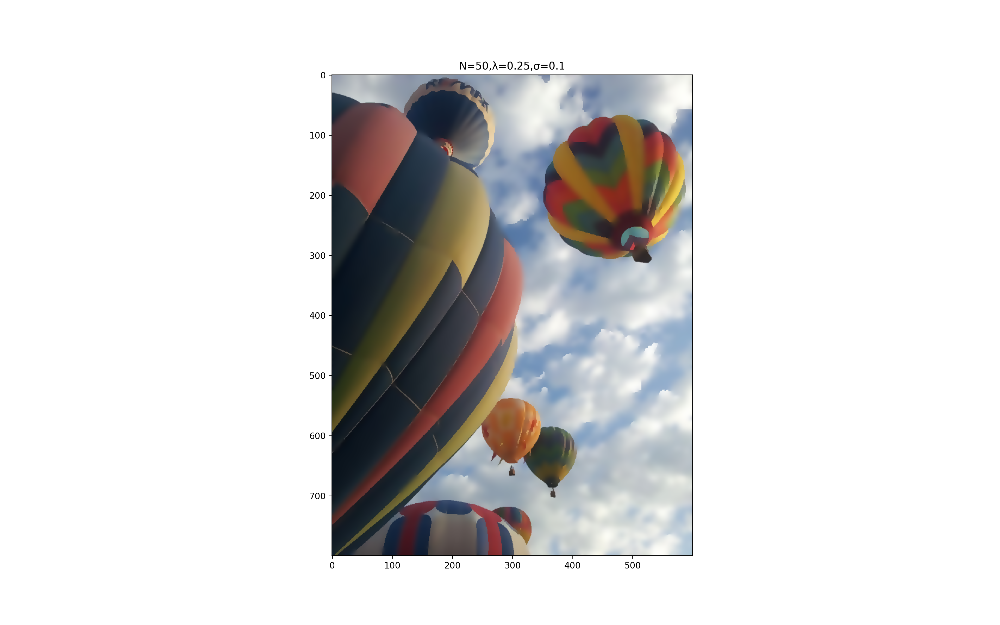

In [6]:
anisdiff_color(U,50,λ,g)

# Problem 3

Run anisdiff_bw() on the noisy image with σ = .1, λ = .25, N = 20. Display the
original image and the noisy image. Explain why anisotropic diusion does not smooth out the
noise.

Use the following code to add noise to your grayscale image.

C:\Users\sgold\AppData\Local\Temp/ipykernel_32968/1455033977.py:1: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imread('balloon.jpg', as_gray=True)


<IPython.core.display.Javascript object>


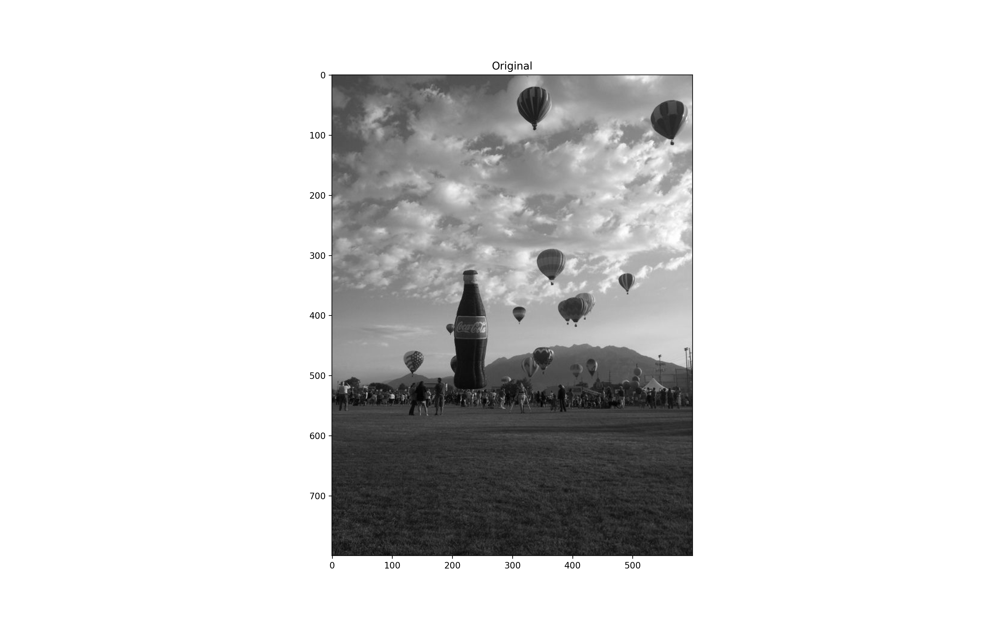

<IPython.core.display.Javascript object>


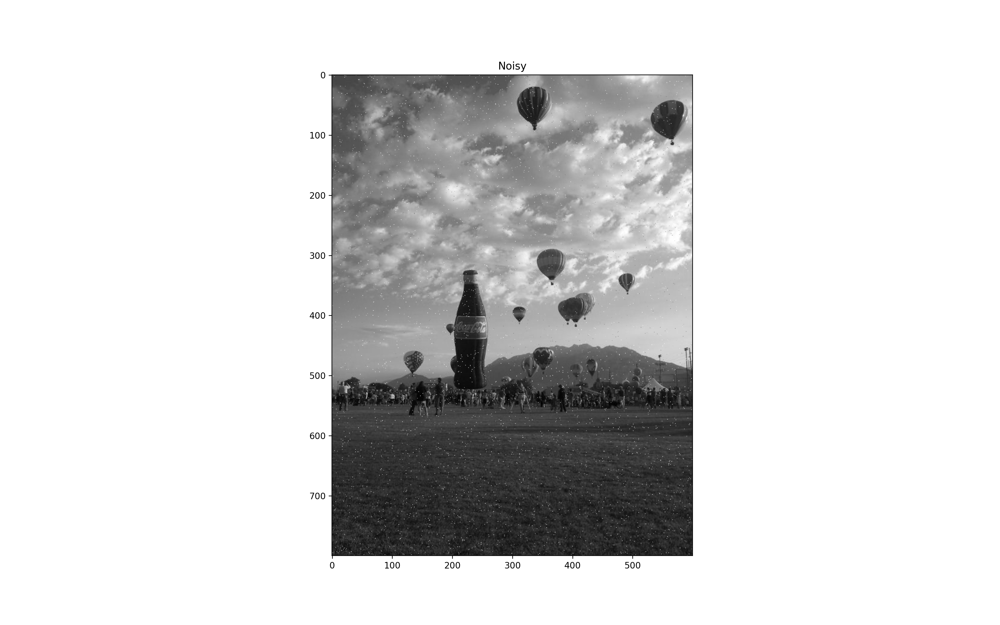

<IPython.core.display.Javascript object>


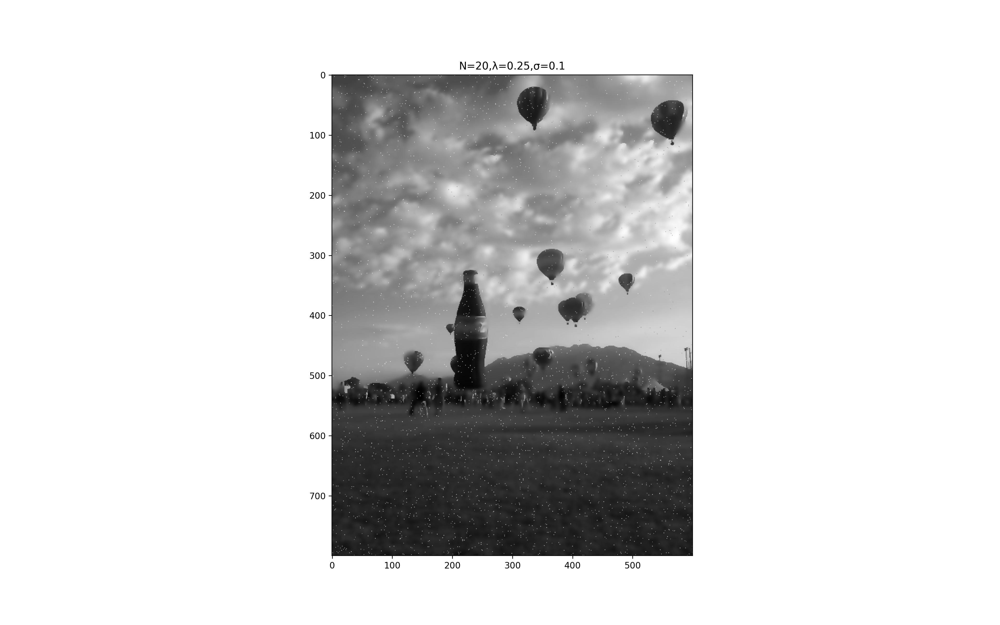

In [7]:
image = imread('balloon.jpg', as_gray=True)
plt.imshow(image, cmap = cm.gray)
plt.title("Original")
plt.show()

x, y = image.shape
for i in range(x*y//100):
    image[randint(x),randint(y)] = 127 + randint(127) #add noise
    
image *= 1./255

#display noise
plt.imshow(image, cmap = cm.gray)
plt.title("Noisy")
plt.show()

#now try to do diffusion
N = 20
anisdiff_bw(image,N,λ,g)
    


Anisotropic diffusion fails to smooth out the noise because it is designed to stop at boundaries. The noise has distinct boundaries, so we don't get the blurring effect on the white spots.